# Introduction

Welcome to the Kalev Candy Object Detection Kaggle competition! In this competition, the task is to detect different types of Kalev candies in images. Our team has created an unique dataset specifically for this competition, and this notebook serves as a starter guide to help you get started with the dataset and code setup.

In [1]:
# First some imports
from PIL import Image
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import json
import pandas as pd
import random

# Dataset and annotations structure

The dataset consists of 501 images, split into 401 training images and 100 test images. Images contain varying numbers of candies, with classes generally well-balanced. We have six candy labels: ``'kaseke', 'maiuspala', 'pralinee', 'ananass', 'mesikapp', 'tiina'`` (example with all the labels and corresponding candies can be found on the competition overview tab). Note that the competition dataset consists of a folder ``train`` with all the training images and folder ``test`` with the testing images meant for only making the predictions. Before exploring the data, let us go over how the competition dataset is structured and how are the annotations formatted.

In [2]:
# Define the general path to the data - note here we are working in a Kaggle notebook, hence the data can be accessed directly by adding it as input
# The dataset is also available for download, so you can work with it locally, if you wish to do so
dataset_path = "/kaggle/input/kalev-candy-detection-competition/"

Let us just look at the first picture from the training dataset. The training image file names follow the format ``train_img_x.jpg``, where ``x`` is a integer between 0 and 400.

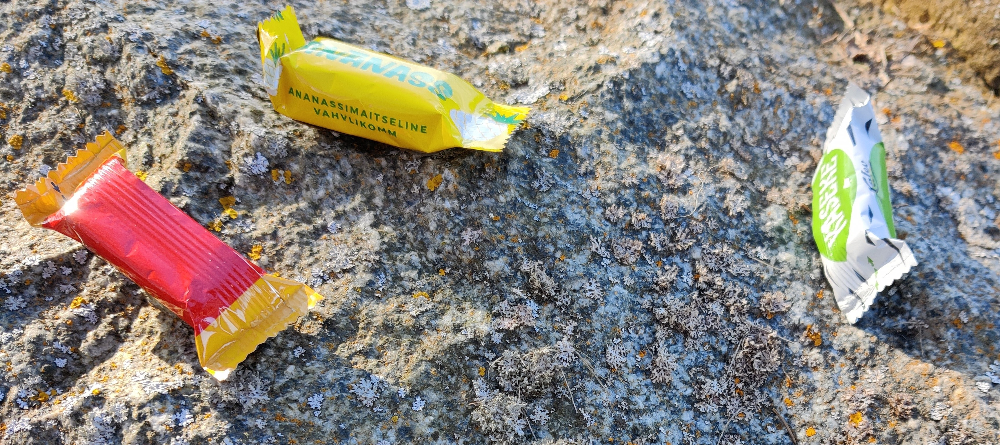

In [3]:
example_image = Image.open(dataset_path + 'train/train_img_0.jpg')
example_image

It is important to note that the provided images are not preprocessed or augmented (metadata has been removed though). Therefore, they have varying height, width, etc, which is important to keep in mind for training models.

The bounding box annotations for the training images are contained in the ``train_labels.json`` file, which is also provided under the competition data. Let us load in the annotations using the json package.

In [4]:
with open(dataset_path + 'train_labels.json') as f:
    annotations_list = json.load(f)
print(f'Resulting object is a {type(annotations_list)} with {len(annotations_list)} items')

Resulting object is a <class 'list'> with 401 items


As we can see, loading in the ``train_labels.json`` file provides us with a Python list that in turn contains Python dictionaries, each of which correspond to a specific training image. Let us look at the dictionary corresponding to the first training image, which we visualized above.

In [5]:
annotations_list[0]

{'image': 'train_img_0.jpg',
 'image_width': 3450,
 'image_height': 1536,
 'bboxes': [{'x': 0.013709039908198368,
   'y': 0.28739002932551305,
   'width': 0.31073823791916316,
   'height': 0.5703812316715542,
   'label': 'mesikapp'},
  {'x': 0.25655488971056983,
   'y': 0.01319648093841642,
   'width': 0.27418079816396773,
   'height': 0.33577712609970667,
   'label': 'ananass'},
  {'x': 0.8114446002805038,
   'y': 0.17595307917888556,
   'width': 0.10836669641718705,
   'height': 0.5542521994134897,
   'label': 'kaseke'}]}

As we can see, every dictionary corresponding to a training image contains the key ``'image'``, which corresponds to the specific image file name, ``'image_width'``, which is the original width of the image and ``'image_height'``, which is the original height of the image. Lastly, we have a key ``'bboxes'``, which corresponds to a list, that contains all of the bounding boxes present in the image as dictionaries.

In [6]:
annotations_list[0]['bboxes'][0] # choose the first bounding box dictionary of the first training image

{'x': 0.013709039908198368,
 'y': 0.28739002932551305,
 'width': 0.31073823791916316,
 'height': 0.5703812316715542,
 'label': 'mesikapp'}

Each bounding box dictionary has the form displayed above. The key ``'x'`` is the **top left** x coordinate of the bounding box, ``'y'`` is the **top left** y coordinate of the bounding box, ``'width'`` is the width of the bounding box and ``'height'`` is the height of the bounding box. Note that all of the coordinates are relative to the original image sizes, i.e. they have been rescaled to the range [0,1] by dividing with the original width or height. The key ``'label'`` corresponds to the class of the bounding box object, which is always one of ``'kaseke', 'maiuspala', 'pralinee', 'ananass', 'mesikapp', 'tiina'``. This formatting of the labels isn't perhaps the most common, but this is how we have implemented it and all of the necessary information should be available for you to convert the labels into the format you require for training.

Now that we have seen the general structure of the data and the annotations, we can do some initial data analysis and visualization.

# Data analysis and visualization

One useful thing to know about our dataset is that every image has atleast one candy present but other than that, the number of candies and the different combinations vary from image to image, as can be seen in the next code blocks, where we count how many images have x candies on them 
and how many appearances different candy classes have throughout the training dataset.

In [7]:
# For counting how many images have x number of candies featured in the training set
images_with_n_candies = dict(zip(range(1,15), [0] * 14))

# For counting the number of occurences of different candy types
candy_appearances = {
    'kaseke': 0,
    'ananass': 0,
    'maiuspala': 0,
    'pralinee': 0,
    'mesikapp': 0,
    'tiina': 0
}

for image in annotations_list:
    images_with_n_candies[len(image['bboxes'])] += 1
    
    for bbox in image['bboxes']:
        candy_appearances[bbox['label']] += 1

In [8]:
pd.DataFrame(images_with_n_candies.items(), columns=['Number of candies in the image', 'Number of images'])

,Number of candies in the image,Number of images
0,1,99
1,2,120
2,3,83
3,4,31
4,5,20
5,6,25
6,7,5
7,8,4
8,9,5
9,10,2


In [9]:
pd.DataFrame(candy_appearances.items(), columns=['Candy label', 'Number of appearances']).sort_values(['Number of appearances'], ascending=False)

,Candy label,Number of appearances
5,tiina,255
4,mesikapp,207
2,maiuspala,206
0,kaseke,204
1,ananass,188
3,pralinee,132


It is also worth knowing that some of the images contain candies that don't belong among our six candy classes. Therefore, your models should learn to ignore them, as our goal is to only detect the six chosen types (therefore they aren't also annotated with bounding boxes). The following is an example image of this (leftmost candy isn't one of our six classes)

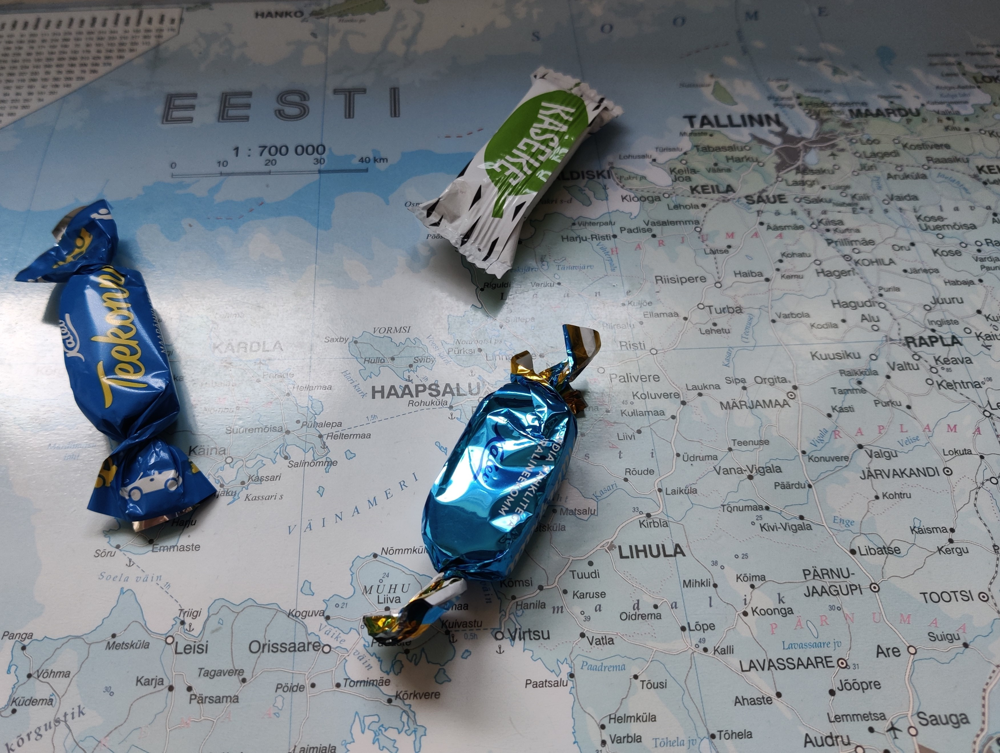

In [10]:
example_image = Image.open(dataset_path + 'train/train_img_71.jpg')
example_image

The following provides you with an example code for visualizing random training images with their respective annotations.

In [11]:
# Define paths to your directories
train_image_dir = "/kaggle/input/kalev-candy-detection-competition/train/"
train_labels_json = "/kaggle/input/kalev-candy-detection-competition/train_labels.json"

# Load the labels from JSON file
with open(train_labels_json, "r") as f:
    labels_list = json.load(f)

train_images = [f'/kaggle/input/kalev-candy-detection-competition/train/train_img_{idx}.jpg' for idx in range(len(labels_list))]
test_images = [f'/kaggle/input/kalev-candy-detection-competition/test/test_img_{idx}.jpg' for idx in range(100)]

# Construct train_df DataFrame
train_df = pd.DataFrame({'image_id': train_images, 'label': labels_list})

# Add full image paths to train_df
train_df['image_path'] = train_df['image_id'].apply(lambda x: os.path.join(train_image_dir, x + '.jpg'))

In [12]:
def display_random_images(image_dir, df, num_images=9, figsize=(15, 15)):
    plt.figure(figsize=figsize)
    plt.subplots_adjust(wspace=0.01, hspace=0.01)
    random_indices = random.sample(range(401), num_images)
    rows = (num_images + 2) // 3  
    cols = min(3, num_images)
    for i, idx in enumerate(random_indices):
        image_id = df.iloc[idx]["image_id"]
        label = df.iloc[idx]["label"]
        image_path = os.path.join(image_dir, image_id)
        image = Image.open(image_path)
        plt.subplot(rows, cols, i + 1)
        plt.imshow(image)
        for bbox in label['bboxes']:
            x, y, w, h = bbox['x'] * image.size[0], bbox['y'] * image.size[1], bbox['width'] * image.size[0], bbox['height'] * image.size[1]
            rect = patches.Rectangle((x, y), w, h, linewidth=1, edgecolor='r', facecolor='none')
            plt.gca().add_patch(rect)
            plt.text(x, y - 5, bbox['label'], color='r', fontsize=12, ha='left', va='top')
        plt.axis("off")
    
    plt.tight_layout()
    plt.show()
    return None

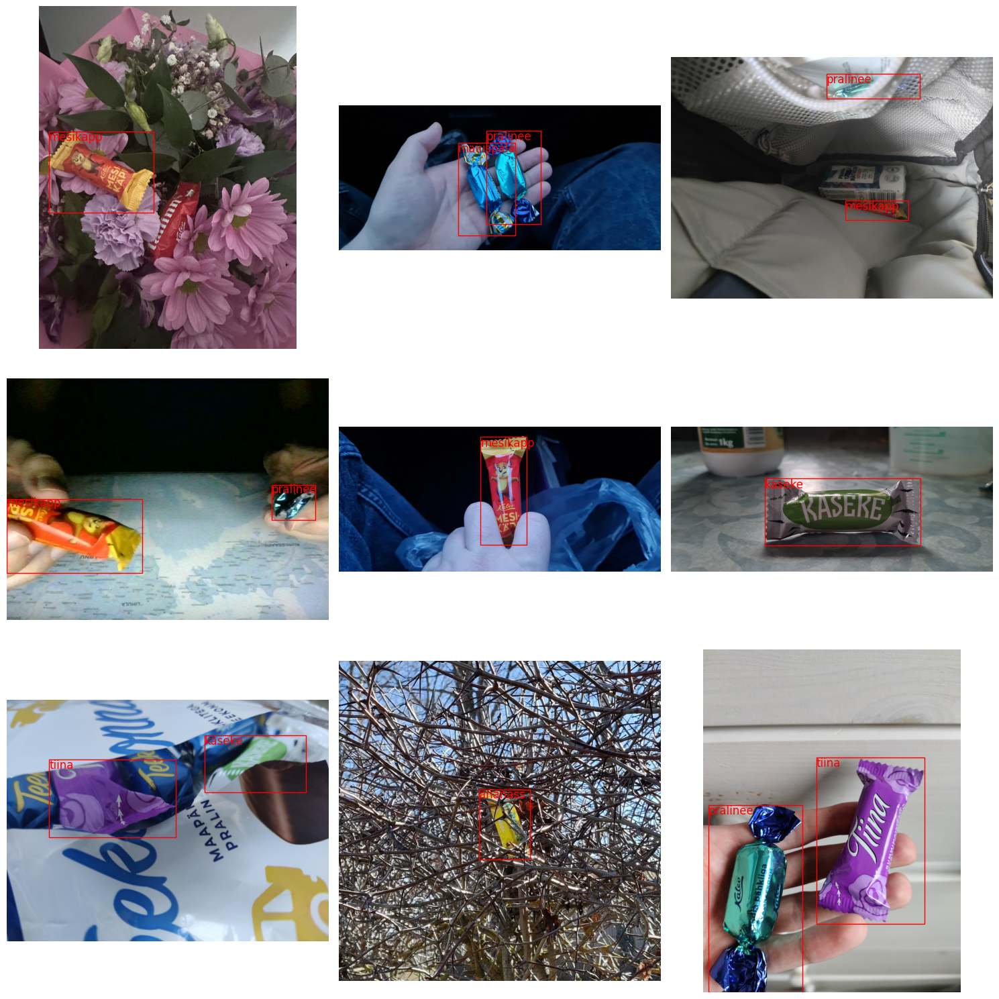

In [13]:
# Display random images from train images
display_random_images(train_image_dir, train_df)

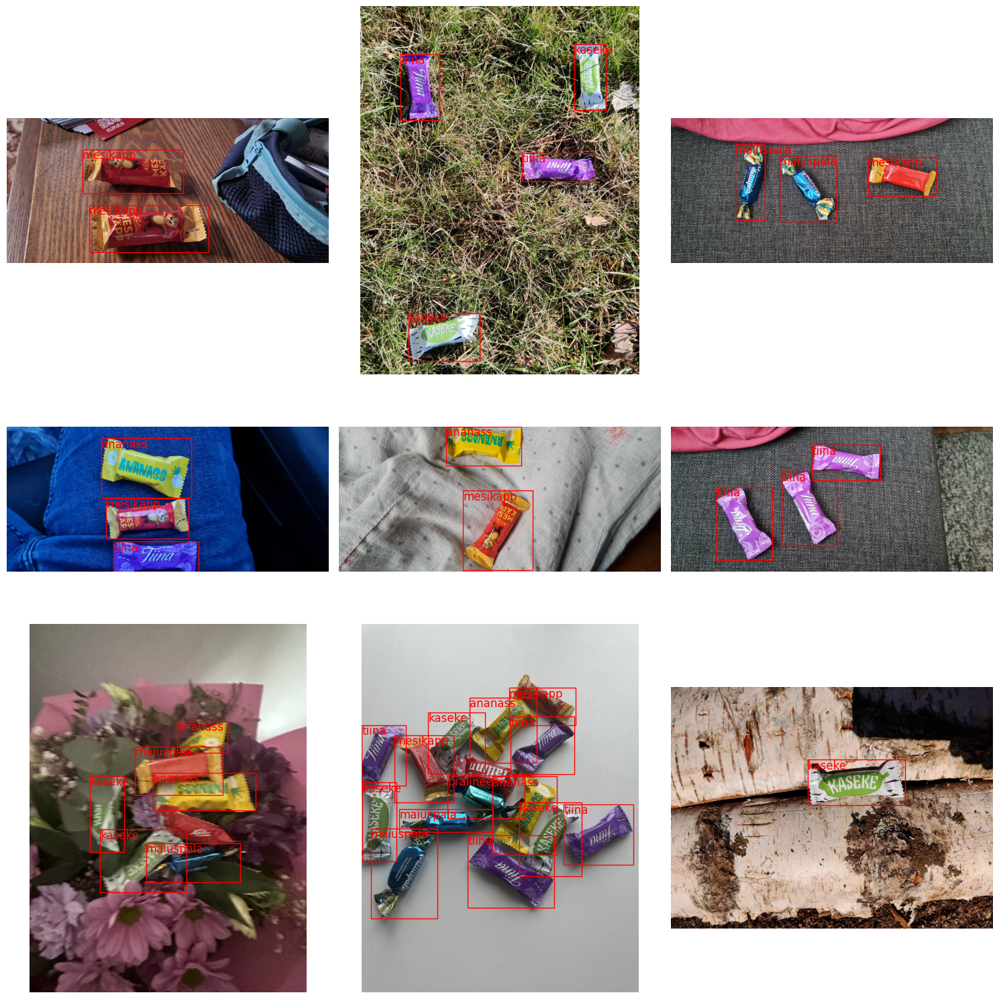

In [14]:
# Some more
display_random_images(train_image_dir, train_df)

# Submission file formatting and example submission

You are required to submit a CSV file, which contains your bounding box predictions for the 100 test images. The CSV file has two columns ``Id`` and ``bboxes``. The ``Id`` column ranges from 0 to 99, corresponding to each test image ``test_img_x.jpg`` in the ``test`` folder. The ``bboxes`` column entries should be lists containing your predicted bounding boxes as dictionaries. The format of the bounding box dictionaries has to be the same as it was for the training annotations, with the distinction that the bbox coordinates, width and height must be scaled to the original image sizes (e.g. if your model outputs a bounding box with relative width of 0.5 and the training image had an original width of 4000 pixels, then you need to present the bbox width as 2000 pixels which is scaled up with respect to the original width - if your model does it automatically then of course there is no extra work for it).

The easiest way to generate a submission file is to create a corresponding pandas dataframe, fill it with your predicted bounding boxes (that you have converted to the required format) and export the dataframe as an CSV file. An empty dataframe can be created as follows:

In [15]:
solutions = pd.DataFrame({'Id': range(100), 'bboxes': [[]] * 100})
solutions

,Id,bboxes
0,0,[]
1,1,[]
2,2,[]
3,3,[]
4,4,[]
...,...,...
95,95,[]
96,96,[]
97,97,[]
98,98,[]


Let us assume, that we have presented ``test_img_0.jpg`` to our model and it has provided us with a bounding box that has a top left x coordinate of ``1136.279``, top left y coordinate of ``740.166``, width ``602.092``, height ``323.681`` and label ``'ananass'``. Note that here the values are already scaled in proportion with the original width and height of ``test_img_0.jpg``. We also provide the top left corner coordinates, which is important to keep in mind. Then the required way to present this bounding box in our format is the following:

In [16]:
bbox = {
    'x': 1136.279,
    'y': 740.166,
    'width': 602.092,
    'height': 323.681,
    'label': 'ananass'
}

As this was a prediction for the first test image, let us add it to the list corresponding to Id 0:

In [17]:
solutions.at[0, 'bboxes'] = [bbox]
solutions

,Id,bboxes
0,0,"[{'x': 1136.279, 'y': 740.166, 'width': 602.09..."
1,1,[]
2,2,[]
3,3,[]
4,4,[]
...,...,...
95,95,[]
96,96,[]
97,97,[]
98,98,[]


Of course, if we have more than one predicted bounding box for the specific image, then we add more dictionaries into the corresponding list (the order of the list itself doesn't matter). Please just make sure that if you don't predict any bounding boxes for a specific image, then still keep the corresponding row in the CSV file and just leave an empty list ``[]``.

Just for demonstration, let us generate the rest of the predictions totally randomly. In reality, you would use your model here to make the predictions and parse them into the required format.

In [18]:
# just a simple label encoding
labels = {0: 'kaseke', 1: 'maiuspala', 2: 'pralinee', 3: 'ananass', 4: 'mesikapp', 5: 'tiina'}

for idx in range(1, 100):
    predicted_bounding_boxes = []
    
    image = Image.open(dataset_path + f'train/train_img_{idx}.jpg')
    
    # choose a random number of bounding boxes to generate
    n = np.random.randint(1, 8)
    
    # create random bounding box predictions
    for i in range(n):
        
        # generate random top left corner coordinates of the bounding box
        x = np.random.uniform()
        y = np.random.uniform()
        
        # scale coordinates to the absolute values with respect to the original image values
        x = image.width * x
        y = image.height * y
        
        # generate random width and height
        width = np.random.uniform(x, image.width)
        height = np.random.uniform(y, image.height)
        
        # generate random label
        label = labels[np.random.randint(0, 6)]
        
        bbox = {
            'x': x,
            'y': y,
            'width': width,
            'height': height,
            'label': label
        }
        
        # add to the prediction list for the image
        predicted_bounding_boxes.append(bbox)
    
    # update the dataframe row
    solutions.at[idx, 'bboxes'] = predicted_bounding_boxes
    

In [19]:
solutions

,Id,bboxes
0,0,"[{'x': 1136.279, 'y': 740.166, 'width': 602.09..."
1,1,"[{'x': 3993.699931949979, 'y': 1974.4816511468..."
2,2,"[{'x': 892.5025844278914, 'y': 252.39055852626..."
3,3,"[{'x': 566.3801643329409, 'y': 529.30650426628..."
4,4,"[{'x': 424.39859594925053, 'y': 811.2177630712..."
...,...,...
95,95,"[{'x': 1716.2131173799603, 'y': 93.47310637907..."
96,96,"[{'x': 518.0807758016433, 'y': 2023.8028042140..."
97,97,"[{'x': 2966.3381514151592, 'y': 3968.982964040..."
98,98,"[{'x': 2691.135323513242, 'y': 847.21834155871..."


Now we can export the created dataframe as an CSV file (if you are following this notebook, make sure to change index to False) and submit it separately:

In [20]:
solutions.to_csv('submission.csv', index=False)

# Good luck!